In [16]:
import numpy as np
import warnings
warnings.filterwarnings('ignore')
import os
import IPython.display as ipd
import matplotlib.pyplot as plt
import librosa
import librosa.display


In [17]:
folder_dir = 'Songs/'
file_paths = []
for file in os.listdir(folder_dir):
    file_paths.append(folder_dir + str(file))
file_paths

['Songs/Brown Munde - AP Dhillon.mp3',
 'Songs/Raataan Lambiyan - Shershaah.mp3',
 'Songs/Ranjha - Shershaah.mp3',
 'Songs/Sawan Mein Lag Gayi Aag - Badshah.mp3',
 'Songs/Tere Bin (Sonu Nigam).mp3']

In [4]:
BM_data,sr = librosa.load(file_paths[0])
ranjha_data,_ = librosa.load(file_paths[2])
terebin_data,_ = librosa.load(file_paths[4])

In [5]:
ipd.Audio(file_paths[0])

In [6]:
ipd.Audio(file_paths[2])

In [7]:
ipd.Audio(file_paths[4])

In [10]:
(len(BM_data) - FRAME_SIZE)//HOP_LENGTH + 1

11524

In [8]:
FRAME_SIZE = 2048
HOP_LENGTH = 512

stft_BM = librosa.stft(BM_data,n_fft=FRAME_SIZE,hop_length=HOP_LENGTH)
print(stft_BM.shape)
stft_BM[0][0] # #freq_bins = frame_size/2 + 1 ; #frames = (samples - frame_size)/hop_length + 1

(1025, 11528)


0j

In [13]:
magnitude_BM = np.abs(stft_BM)**2
print(magnitude_BM.shape)
print(type(magnitude_BM[0][0]))

(1025, 11528)
<class 'numpy.float32'>


In [26]:
def plot_spectogram(data,sr,hop_length,y_axis = "linear"):
    plt.figure(figsize = (25,10))
    librosa.display.specshow(data,sr = sr,hop_length=hop_length,x_axis="time",y_axis=y_axis)
    plt.colorbar()

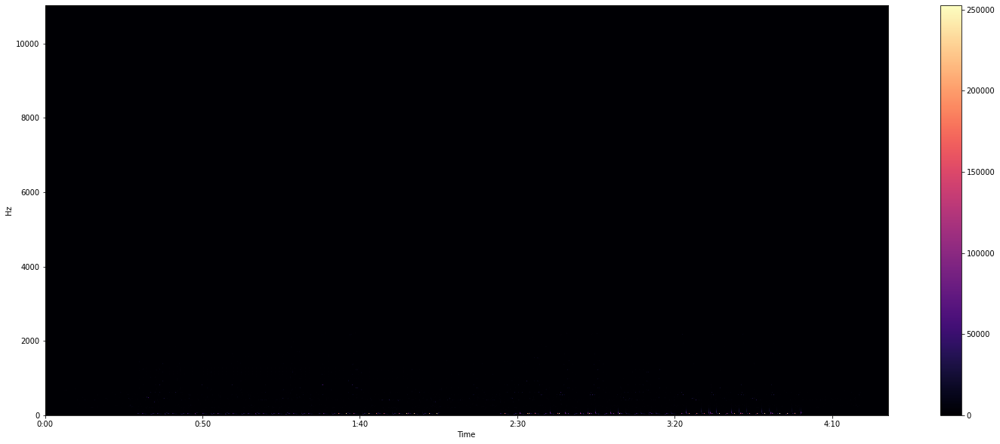

In [28]:
## The reason that we are unable to see clear points is because magnitude/intensity is on linear but we perceive them on
## logarithmic scale ie loudness
plot_spectogram(magnitude_BM,sr=sr,hop_length=HOP_LENGTH)

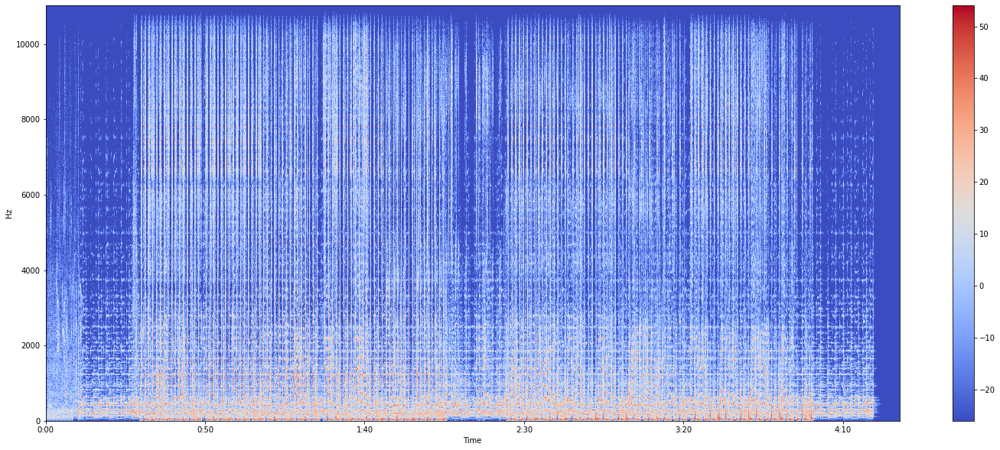

In [27]:
log_magnitude_BM = librosa.power_to_db(magnitude_BM)
plot_spectogram(log_magnitude_BM,sr = sr,hop_length=HOP_LENGTH)

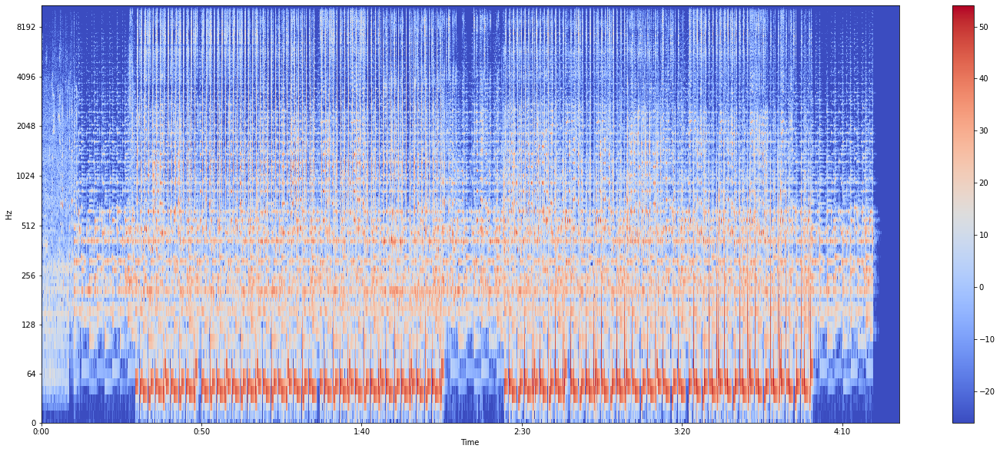

In [29]:
## Similarly with frequency scale we percieve it as pitch which is a log scale
plot_spectogram(log_magnitude_BM,sr = sr,hop_length=HOP_LENGTH,y_axis='log')

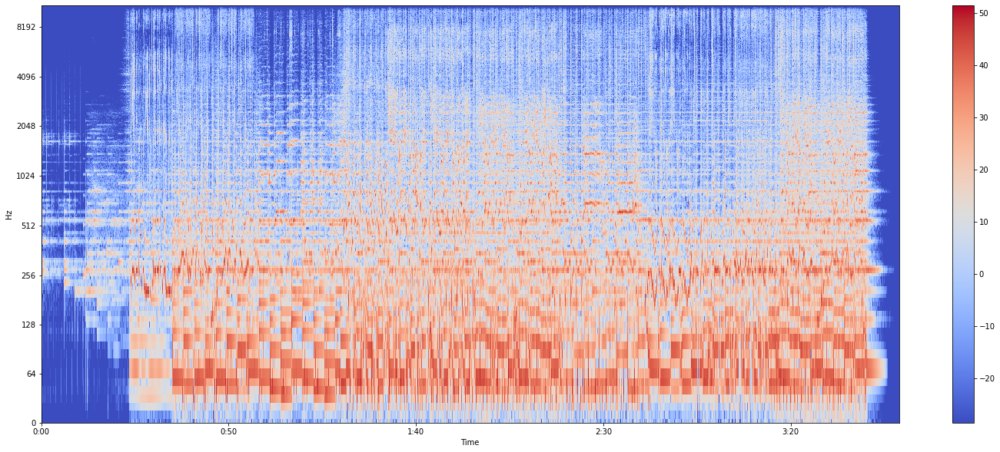

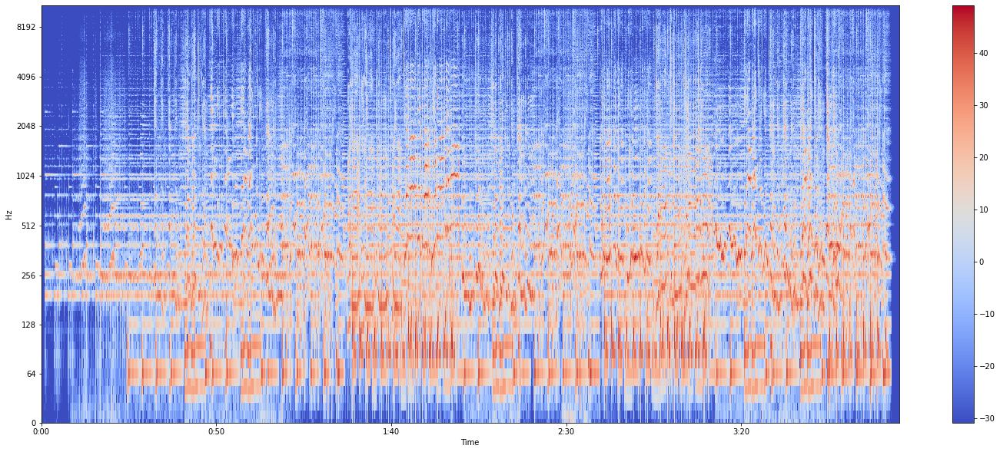

In [31]:

stft_ranjha = librosa.stft(ranjha_data,n_fft=FRAME_SIZE,hop_length=HOP_LENGTH)
stft_terebin = librosa.stft(terebin_data,n_fft=FRAME_SIZE,hop_length=HOP_LENGTH)
scaled_magnitude_ranjha = librosa.power_to_db(np.abs(stft_ranjha)**2)
scaled_magnitude_terebin = librosa.power_to_db(np.abs(stft_terebin)**2)

plot_spectogram(scaled_magnitude_ranjha,sr =  sr,hop_length=HOP_LENGTH,y_axis='log')
plot_spectogram(scaled_magnitude_terebin,sr = sr,hop_length=HOP_LENGTH,y_axis='log')